# **Top Highlights  📌**


---

1. Trained a `Word2Vec CBOW` model from scratch following the [paper.](https://arxiv.org/abs/1301.3781)

2. Explored the effect of switching out the `Mean` layer with a `GlobalAveragePooling1D` layer which lead to better results. 

3. Explored the effect of lemmatization and concluded that it does not make a lot of difference in model performance (in terms of training time or quality of embeddings).

---





# **Assignment Layout  📎** 

---

1. **Examine & Preprocess:** In this section we examine the data and set up some cleaning steps

2. **Preparing Inputs:** Next, we make decisions with regards to vocabulary size, tokenize the data, and prepare generators to feed inputs to the model.

3. **Model Training:** A Word2Vec CBOW (Continuous Bag of Words) model is implemented and trained from scatch. 

4. **Visualizations:** Finally, the learnt embeddings are visualized through `TensorBoard`.

5. **Conclusions:** Summary and final words.


---




In [ ]:
import tensorflow as tf
import tensorflow_addons as tfa
import tensorflow.keras.backend as K
import os
import string
import re
import math
import time
import textwrap
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import spacy
nlp = spacy.load('en_core_web_sm')

from collections import Counter
from tqdm.notebook import tqdm
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.preprocessing.text import Tokenizer
from gensim.parsing.preprocessing import remove_stopwords
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Embedding, Lambda, GlobalAveragePooling1D
from sklearn.metrics.pairwise import cosine_similarity

In [ ]:
!nvidia-smi

Sat Sep  5 12:28:54 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.66       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P0    33W / 250W |    529MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## **Examine & Preprocess 🔍**


---

* Even though the data is from WikiPedia, it may seem like there is no need to do any preprocessing. 

* However, our goal is to create meaningful word embeddings and not text generation or classification, and therefore we must examine the data to find out if we can achieve our goal **without** preprocesing. 

---





### **A Look at the Data**

In [ ]:
corpus = open('/content/wiki.train.tokens', 'r', encoding = "utf-8").read().lower()

In [ ]:
print(corpus[:1000])
text = corpus[:1000]
print(textwrap.fill(text,  width = 70))

 
 = valkyria chronicles iii = 
 
 senjō no valkyria 3 : <unk> chronicles ( japanese : 戦場のヴァルキュリア3 , lit . valkyria of the battlefield 3 ) , commonly referred to as valkyria chronicles iii outside japan , is a tactical role @-@ playing video game developed by sega and media.vision for the playstation portable . released in january 2011 in japan , it is the third game in the valkyria series . <unk> the same fusion of tactical and real @-@ time gameplay as its predecessors , the story runs parallel to the first game and follows the " nameless " , a penal military unit serving the nation of gallia during the second europan war who perform secret black operations and are pitted against the imperial unit " <unk> raven " . 
 the game began development in 2010 , carrying over a large portion of the work done on valkyria chronicles ii . while it retained the standard features of the series , it also underwent multiple adjustments , such as making the game more <unk> for series newcomers . char

#### **Observations**



---


1. Remove punctuations because they do not add any meaning and we do not want to learn embeddings for them either.

2. Remove special characters (like, Japanese, new line characters, #, @ etc).

3. Remove numbers and Roman numerals (since the data is taken from Wikipedia, there are bound be lots of Roman numerals.

4. Remove Stop Words.

5. Remove extra spaces in between.

6. There are a lot of pronouns, common-nouns but we should not remove them since we want the embeddings to learn relationships like Jupiter -> Europa, Ganymede etc.

---



### **Load Dataset**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
4/4AE4-G1TptxKrvzLkUTppsEErXupTScoEjlCPp2W0YnywloxJjwkcsE
Mounted at /content/drive


In [ ]:
corpus = open('/content/wiki.train.tokens', 'r', encoding = "utf-8").read()

### **Apply Processing Steps**

In [ ]:
def process_punctuation(text):
  return text.translate(str.maketrans('', '', string.punctuation))

def process_numbers(text):
  return text.translate(str.maketrans('', '', string.digits))

def process_roman_numerals(text):
  return re.sub(r"\b(?=[MDCLXVI]+\b)M{0,4}(CM|CD|D?C{0,3})(XC|XL|L?X{0,3})(IX|IV|V?I{0,3})\b", "", text).lower()

def process_special_characters(text):
  return re.sub(r'[^\x00-\x7f]|(\n)', '', text)

def process_unk_token(text):
  return text.replace('unk', '')

def process_stop_words(text):
  return remove_stopwords(text)

def process_lemmatization(text):
  doc = nlp(text)
  lemma = ' '.join([w.lemma_ if w.lemma_ != '-PRON-' else w.text for w in doc])
  return re.sub(r'\s([?,.!"](?:\s|$))', r'\1', lemma)

def process_extra_spaces(text):
  return re.sub(r' +', ' ', text).strip()   

def process_all(text):
  text = process_punctuation(text)
  text = process_numbers(text)
  text = process_roman_numerals(text)
  text = process_special_characters(text)
  text = process_unk_token(text)
  text = process_stop_words(text)
  text = process_extra_spaces(text)
  return text   

In [ ]:
# chunk_size = int(len(text) / 7)
# lemma = ''
# for i in range(7):
#     chunk = text[(i) * chunk_size : (i + 1) * chunk_size]
#     doc = nlp(chunk)
#     lemma += ' '  + ' '.join([w.lemma_ if w.lemma_ != '-PRON-' else w.text for w in doc]).strip()
    
# text_after = re.sub(r'\s([?,.!"](?:\s|$))', r'\1', lemma)

# print(len(text_after.split(' ')))

In [ ]:
# display some text before cleaning
print("*** BEFORE CLEANING ***\n\n {}".format(textwrap.fill(corpus[:1000])))

# clean text
corpus = process_all(corpus)

# display some text after cleaning
print("\n\n*** AFTER CLEANING ***\n\n {}".format(textwrap.fill(corpus[:1000])))

*** BEFORE CLEANING ***

    = Valkyria Chronicles III =     Senjō no Valkyria 3 : <unk>
Chronicles ( Japanese : 戦場のヴァルキュリア3 , lit . Valkyria of the
Battlefield 3 ) , commonly referred to as Valkyria Chronicles III
outside Japan , is a tactical role @-@ playing video game developed by
Sega and Media.Vision for the PlayStation Portable . Released in
January 2011 in Japan , it is the third game in the Valkyria series .
<unk> the same fusion of tactical and real @-@ time gameplay as its
predecessors , the story runs parallel to the first game and follows
the " Nameless " , a penal military unit serving the nation of Gallia
during the Second Europan War who perform secret black operations and
are pitted against the Imperial unit " <unk> Raven " .   The game
began development in 2010 , carrying over a large portion of the work
done on Valkyria Chronicles II . While it retained the standard
features of the series , it also underwent multiple adjustments , such
as making the game more <unk> f


---
*A Note on Lemmatization:* 

1. *We do not prefer to lemmatize the corpus because we are creating word embeddings and these word embeddigs may be used as an intialization point for some other downstream tasks like text generation (the data used text generation is not preferred lemmatized)* 

2. *Secondly, in experiments it was found that lemmatization did not help the performance of the trained model in terms of training time or with the quality of embeddings.*

---




## **Build Inputs 🔨**


---

* The `Word2Vec CBOW` model works in the following way:

  * It takes some tokens from the corpus (say, 5)

  * It **masks** the middle token (the 3rd token)
  
  * And then tries to **predict the middle token** out of the original five tokens it had picked up.

  * This enables the model to learn which **type of words occur more commonly with which other type of words.**

  * This **guides** the **embedding creation** process.  

* Therefore, we must decide on our vocabulary and **tokenize** our data.

* **After which, we need to create a generator function which scans the corpus and gives out tokens (of a desired window size, with desired overlap and for a desired batch size)**
---





### **Selecting Vocabulary Size**

In [ ]:
def tokenize_corpus(corpus):
  tokenizer = Tokenizer(filters='#$%&*+/<=>@^_`{|}~', oov_token= '<UNK>')
  tokenizer.fit_on_texts(corpus.split(" "))
  return tokenizer


def plot_top_n_perc(tokenizer, top_n_list):
  total_words = sum([value for value in tokenizer.word_counts.values()])
  top_n_cumm = [sum([value[1] for value in Counter(tokenizer.word_counts).most_common(top_n)]) * 100 / total_words for top_n in top_n_list]
  to_plot = {'Top {} Words'.format(top_n) :  top_n_cumm[idx] for idx, top_n in enumerate(top_n_list)}

  plt.style.use('seaborn-darkgrid')
  plt.style.use('seaborn-pastel')
  plt.figure(figsize=(30, 15))
  plt.title('Top N words as percentage of the corpus', fontdict= {'fontsize':28})
  plt.bar(list(to_plot.keys()), list(to_plot.values()))
  plt.tick_params(labelsize=18)
  plt_round = [round(value, 2) for value in list(to_plot.values())]
  for i in range(len(to_plot)):
    plt.annotate(str(plt_round[i]) + '%', xy=(list(to_plot.keys())[i], list(to_plot.values())[i]), size=18)
  plt.show()

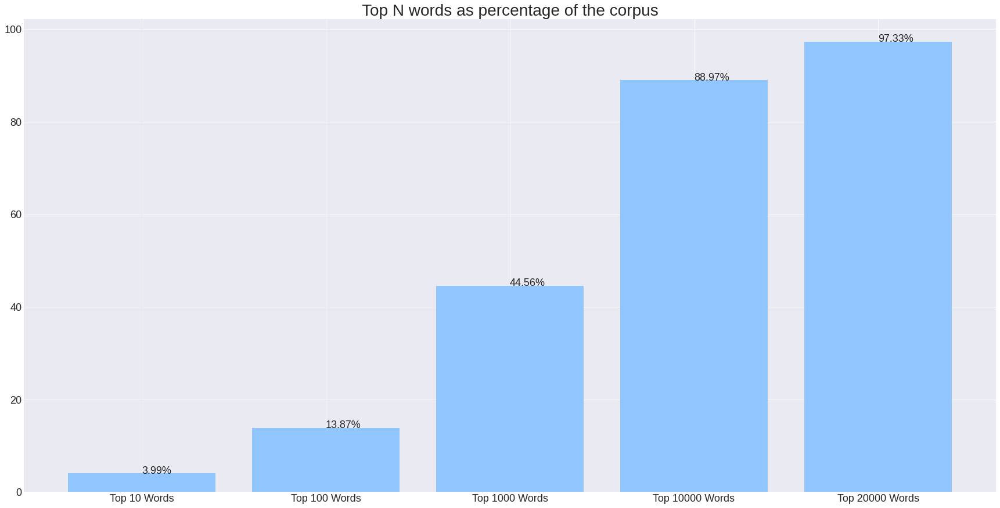


Total words in the corpus: 862080, unique are: 26952


In [ ]:
tokenizer = tokenize_corpus(corpus)
plot_top_n_perc(tokenizer, top_n_list = [10, 100, 1000, 10000, 20000])
print("\nTotal words in the corpus: {}, unique are: {}".format(len(corpus.split(" ")), len(list(set(corpus.split())))))

#### **Conclusion**


---

Our Vocabulary size must be 20,000 or 20K words.

---




### **Tokenization**

In [ ]:
# limit vocab to 20K words
def tokenize_corpus(corpus):
  tokenizer = Tokenizer(num_words = 20000, filters='#$%&*+/<=>@^_`{|}~', oov_token= '<UNK>')
  tokenizer.fit_on_texts(corpus.split(" "))
  return tokenizer

# load tokenizer
tokenizer = tokenize_corpus(corpus)

# encode the corpus
encoded_corpus = tokenizer.texts_to_sequences(corpus.split(" "))

### **Prepare Inputs**

In [ ]:
# generators for batch loading
def get_batch(corpus, batch_sz, window_sz, skip, train_split, subset):
  window_length = (window_sz * 2) + 1
  centre = window_length // 2
  overlap = window_length - skip

  chunk_length = (batch_sz * skip) + (window_length - overlap)
  train_batches = math.floor((len(corpus) //  (chunk_length)) * train_split)
  total_batches = math.floor((len(corpus) //  (chunk_length)))

  if subset == 'train':
    for offset in range(0, train_batches * chunk_length, chunk_length):
      x_batch = [corpus[offset + (skip * i) : offset + (skip * i) + centre]  + corpus[offset + (skip * i) + centre + 1 : offset + (skip * i) + window_length] for i in range(batch_sz)] 
      y_batch = [corpus[offset + (skip * i) + centre] for i in range(batch_sz)]
      yield np.squeeze(np.array(x_batch)), np.array(y_batch)

  if subset == 'val':
    for offset in range(train_batches * chunk_length, total_batches * chunk_length, chunk_length):
      x_batch = [corpus[offset + (skip * i) : offset + (skip * i) + centre]  + corpus[offset + (skip * i) + centre + 1 : offset + (skip * i) + window_length] for i in range(batch_sz)] 
      y_batch = [corpus[offset + (skip * i) + centre] for i in range(batch_sz)]
      yield np.squeeze(np.array(x_batch)), np.array(y_batch)


## **Model Training 🚀**

In [ ]:
# define data generator related variables
batch_sz = 32
window_sz = 2
skip = 1
train_split = 0.9

# define model related variables
vocab = 20000
embedding_dim = 100


# build CBOW architecture
model = Sequential()
model.add(Embedding(input_dim=vocab, output_dim=embedding_dim, input_length = window_sz * 2))
#model.add(Lambda(lambda x: K.mean(x, axis=1), output_shape=(embedding_dim,)))
model.add(GlobalAveragePooling1D())
model.add(Dense(vocab, activation='softmax'))
model.compile(loss='sparse_categorical_crossentropy', optimizer='adam')

# view model summary
print(model.summary())

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_5 (Embedding)      (None, 4, 100)            2000000   
_________________________________________________________________
lambda (Lambda)              (None, 100)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 20000)             2020000   
Total params: 4,020,000
Trainable params: 4,020,000
Non-trainable params: 0
_________________________________________________________________
None


In [ ]:
# define model training related variables
epochs = 30
window_length = (window_sz * 2) + 1
overlap = window_length - skip
chunk_length = (batch_sz * skip) + (window_length - overlap)
train_batches = math.floor((len(encoded_corpus) //  (chunk_length)) * train_split)
total_batches = math.floor((len(encoded_corpus) //  (chunk_length)))

val_dataloader = get_batch(encoded_corpus, batch_sz, window_sz, skip, train_split, subset='val')


for epoch in range(epochs):
  print("#" * 20 + ' ' + str(epoch+1) + ' ' + "#" * 20)
  train_dataloader =  get_batch(encoded_corpus, batch_sz, window_sz, skip, train_split, subset = 'train')

  for batch in tqdm(range(train_batches)):
    x_batch, y_batch = next(train_dataloader)
    loss = model.train_on_batch(x_batch, y_batch, reset_metrics=False)

  print("\n### EVALUATION ###")
  x_val, y_val = next(val_dataloader)
  val_loss = model.test_on_batch(x_val, y_val)
  print("Training Loss after {} epoch(s): {}".format(epoch+1, loss))
  print("Validation Loss after {} epoch(s): {}\n".format(epoch+1, val_loss))

#################### 1 ####################




### EVALUATION ###
Training Loss after 1 epoch(s): 8.91832160949707
Validation Loss after 1 epoch(s): 8.918328285217285

#################### 2 ####################




### EVALUATION ###
Training Loss after 2 epoch(s): 8.230524063110352
Validation Loss after 2 epoch(s): 8.230560302734375

#################### 3 ####################




### EVALUATION ###
Training Loss after 3 epoch(s): 7.754258632659912
Validation Loss after 3 epoch(s): 7.754323959350586

#################### 4 ####################




### EVALUATION ###
Training Loss after 4 epoch(s): 7.357660293579102
Validation Loss after 4 epoch(s): 7.357749938964844

#################### 5 ####################




### EVALUATION ###
Training Loss after 5 epoch(s): 7.029520511627197
Validation Loss after 5 epoch(s): 7.029622554779053

#################### 6 ####################




### EVALUATION ###
Training Loss after 6 epoch(s): 6.786029815673828
Validation Loss after 6 epoch(s): 6.786106586456299

#################### 7 ####################




### EVALUATION ###
Training Loss after 7 epoch(s): 6.608114719390869
Validation Loss after 7 epoch(s): 6.6082682609558105

#################### 8 ####################




### EVALUATION ###
Training Loss after 8 epoch(s): 6.475452899932861
Validation Loss after 8 epoch(s): 6.475574016571045

#################### 9 ####################




### EVALUATION ###
Training Loss after 9 epoch(s): 6.374871253967285
Validation Loss after 9 epoch(s): 6.3749918937683105

#################### 10 ####################




### EVALUATION ###
Training Loss after 10 epoch(s): 6.298287391662598
Validation Loss after 10 epoch(s): 6.298483848571777

#################### 11 ####################




### EVALUATION ###
Training Loss after 11 epoch(s): 6.239136219024658
Validation Loss after 11 epoch(s): 6.239277362823486

#################### 12 ####################




### EVALUATION ###
Training Loss after 12 epoch(s): 6.193735122680664
Validation Loss after 12 epoch(s): 6.1939239501953125

#################### 13 ####################




### EVALUATION ###
Training Loss after 13 epoch(s): 6.158919811248779
Validation Loss after 13 epoch(s): 6.159071445465088

#################### 14 ####################




### EVALUATION ###
Training Loss after 14 epoch(s): 6.132550239562988
Validation Loss after 14 epoch(s): 6.132688999176025

#################### 15 ####################




### EVALUATION ###
Training Loss after 15 epoch(s): 6.112767696380615
Validation Loss after 15 epoch(s): 6.112987995147705

#################### 16 ####################




### EVALUATION ###
Training Loss after 16 epoch(s): 6.098613262176514
Validation Loss after 16 epoch(s): 6.098729133605957

#################### 17 ####################




### EVALUATION ###
Training Loss after 17 epoch(s): 6.088773727416992
Validation Loss after 17 epoch(s): 6.088922023773193

#################### 18 ####################




### EVALUATION ###
Training Loss after 18 epoch(s): 6.082809925079346
Validation Loss after 18 epoch(s): 6.082918167114258

#################### 19 ####################




### EVALUATION ###
Training Loss after 19 epoch(s): 6.079710483551025
Validation Loss after 19 epoch(s): 6.079911708831787

#################### 20 ####################




### EVALUATION ###
Training Loss after 20 epoch(s): 6.079093933105469
Validation Loss after 20 epoch(s): 6.079232215881348

#################### 21 ####################




### EVALUATION ###
Training Loss after 21 epoch(s): 6.080230712890625
Validation Loss after 21 epoch(s): 6.080435752868652

#################### 22 ####################


## **Visualization in TensorBoard 😍**

In [ ]:
try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass

%load_ext tensorboard

from tensorboard.plugins import projector

In [ ]:
log_dir= '/content/drive/My Drive/logs_embedding3/imdb-example/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

# Save Labels separately on a line-by-line manner.
with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  for words, index in tokenizer.word_index.items():
    if index == 20000:
      break
    f.write("{}\n".format(words))

  # Fill in the rest of the labels with "unknown"
  for unknown in range(1,  len(tokenizer.word_index) - tokenizer.num_words):
    f.write("unknown #{}\n".format(unknown))  

# Save the weights we want to analyse as a variable. Note that the first
# value represents any unknown word, which is not in the metadata, so
# we will remove that value.
weights = tf.Variable(model.layers[0].get_weights()[0][1:])
# Create a checkpoint from embedding, the filename and key are
# name of the tensor.
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

# Set up config
config = projector.ProjectorConfig()
embedding = config.embeddings.add()
# The name of the tensor will be suffixed by `/.ATTRIBUTES/VARIABLE_VALUE`
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)

In [ ]:
%tensorboard --logdir '/content/drive/My Drive/logs_embedding3/imdb-example'

Reusing TensorBoard on port 6006 (pid 1285828), started 0:00:20 ago. (Use '!kill 1285828' to kill it.)

<IPython.core.display.Javascript object>

## **Similarity Finder  🔍**

---
This section contains simple utility functions to find out similar words based on the trained embeddings. 

---




In [ ]:
def load_embeddings_from_checkpoint(path_to_embeddings):
  vocab = 20000
  embedding_dim = 100
  weights = np.zeros((vocab-1, embedding_dim), dtype='float32')
  weights = tf.Variable(weights)
  checkpoint = tf.train.Checkpoint(embedding = weights)
  status = checkpoint.restore(path_to_embeddings).assert_consumed()
  return weights.numpy()


def create_lookup(weights, path_to_meta):
  df_words = pd.read_csv(path_to_meta, sep='/t', header=None)[:19999]
  lookup = pd.DataFrame(weights)
  lookup['words'] = df_words
  assert len(df_words) == len(lookup)
  return lookup


def get_n_similar_words(lookup, n):
  word = input('Enter WORD to compare: ')
  search_word_embedding = lookup[lookup['words'] == word].drop('words', axis=1).to_numpy()
  all_word_embeddings = lookup.drop('words', axis=1).to_numpy()
  sim = cosine_similarity(search_word_embedding, all_word_embeddings).squeeze()
  top_n = (-sim).argsort()[:10]
  matched_words = [lookup["words"].iloc[i] for i in top_n]
  print("Similar WORDS found: {}".format(matched_words))

In [ ]:
weights = load_embeddings_from_checkpoint(path_to_embeddings = "/content/drive/My Drive/logs_embedding3/imdb-example/embedding.ckpt-1")
lookup = create_lookup(weights, path_to_meta = "/content/drive/My Drive/logs_embedding3/imdb-example/metadata.tsv")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:12: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  if sys.path[0] == '':


In [ ]:
get_n_similar_words(lookup, n = 10)

Enter WORD to compare: war
Similar WORDS found: ['war', 'army', 'wars', 'conflict', 'period', 'campaign', 'unrest', 'military', 'liberties', 'battle']


## **Conclusion ⚖️**


---

1. Even with ~20 epochs of training, we were able to generate fairly meaningful embeddings. 

2. Using a `GlobalAveragePooling1D` layer gives slightly better results than `Mean` or `Average` layers.

3. Lemmatization does not improve the model performance in terms of training time or with respect to the quality of embeddings. 

4. Words which occur very infrequently or the ones that make no sense have a very distinct cluster in the embedding space.

5. A similarity finder utility was implemented which gave semantically similar words based on the search word.

---


